# Preprocessing Experiment 2

## Initialisation and reading data

In [1]:
import numpy as np                                # scientific computing toolkit
import pandas as pd                               # data analysis toolkit
import scanpy as sc                               # scanpy is referred to with sc.***
import matplotlib.pyplot as plt                   # Matplotlib is referred to with plt.***
from scipy import stats                           # for linear regressions
import seaborn as sns                             # for easy heatmaps
import scirpy as ir

sc.settings.verbosity = 0                         # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.logging.print_header()                       # check if all needed versions are installed and up to date
results_file = './write/results.h5ad'             # the file that will store the analysis results

scanpy==1.4.3 anndata==0.7.5 umap==0.4.6 numpy==1.19.4 scipy==1.5.1 pandas==1.1.5 scikit-learn==0.21.3 statsmodels==0.11.1 python-igraph==0.7.1+4.bed07760 louvain==0.6.1 leidenalg==0.7.0


In [2]:
sc.settings.set_figure_params(dpi=80, dpi_save=200, color_map='viridis')

In [3]:
adata_1 = sc.read_10x_mtx(
    "./GEX_1/outs/filtered_feature_bc_matrix/",  # the directory with the `.mtx` file
    var_names='gene_symbols',                  # use gene symbols for the variable names (variables-axis index)
    cache=True, gex_only=False)                                # write a cache file for faster subsequent reading
adata_1.var_names_make_unique()  # this is unnecessary if using 'gene_ids'
adata_1   # Gives an output of the actual variables stored in adata (cells x genes)

AnnData object with n_obs × n_vars = 8371 × 36607
    var: 'gene_ids', 'feature_types'

In [4]:
adata_2 = sc.read_10x_mtx(
    "./GEX_2/outs/filtered_feature_bc_matrix/",  # the directory with the `.mtx` file
    var_names='gene_symbols',                  # use gene symbols for the variable names (variables-axis index)
    cache=True, gex_only=False)                                # write a cache file for faster subsequent reading
adata_2.var_names_make_unique()  # this is unnecessary if using 'gene_ids'
adata_2   # Gives an output of the actual variables stored in adata (cells x genes)

AnnData object with n_obs × n_vars = 5571 × 36607
    var: 'gene_ids', 'feature_types'

In [5]:
adatas = [adata_1,adata_2]
names = ["Sample 1", "Sample 2"]

In [6]:
y_genes=pd.read_csv("./analysis_info/Ygenes.csv", sep=';')
y_genes_list=y_genes.gene.tolist()
sc.tl.score_genes(adatas[0], y_genes_list, score_name='male_score')
sc.tl.score_genes(adatas[1], y_genes_list, score_name='male_score')

In [7]:
adatas_HTO=[0]*2
for i, adata in enumerate(adatas):
    adatas_HTO[i]=adata[:, adata.var_names.isin(['HM081', 'HM117', 'HM121', 'HM138', 'HM188', 'HM206','HM110','HM180','HM195'])]
    #sc.pp.normalize_per_cell(adatas_HTO[i], counts_per_cell_after=1e4, min_counts=0)
    sc.pp.log1p(adatas_HTO[i])
    adatas_HTO[i].obs['staining_int']=[adatas[i].X[x,:].sum() for x in range(adatas[i].shape[0])]
    sc.pp.scale(adatas_HTO[i], max_value=10)
    sc.tl.pca(adatas_HTO[i])
    sc.pp.neighbors(adatas_HTO[i], n_neighbors=100)
    sc.tl.umap(adatas_HTO[i], spread=75, min_dist=1)
    sc.tl.leiden(adatas_HTO[i], resolution=0.2)

C:\ProgramData\Anaconda3\lib\site-packages\scanpy\preprocessing\_simple.py:339: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)
C:\Users\Administrator\AppData\Roaming\Python\Python36\site-packages\umap\umap_.py:1158: RuntimeWarning: divide by zero encountered in power
  return 1.0 / (1.0 + a * x ** (2 * b))
C:\ProgramData\Anaconda3\lib\site-packages\scanpy\preprocessing\_simple.py:339: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)
C:\Users\Administrator\AppData\Roaming\Python\Python36\site-packages\umap\umap_.py:1158: RuntimeWarning: divide by zero encountered in power
  return 1.0 / (1.0 + a * x ** (2 * b))


In [8]:
keys=[adata_1.var_names[adata_1.var.feature_types=='Antibody Capture'],adata_2.var_names[adata_2.var.feature_types=='Antibody Capture']]

Sample 1


... storing 'feature_types' as categorical


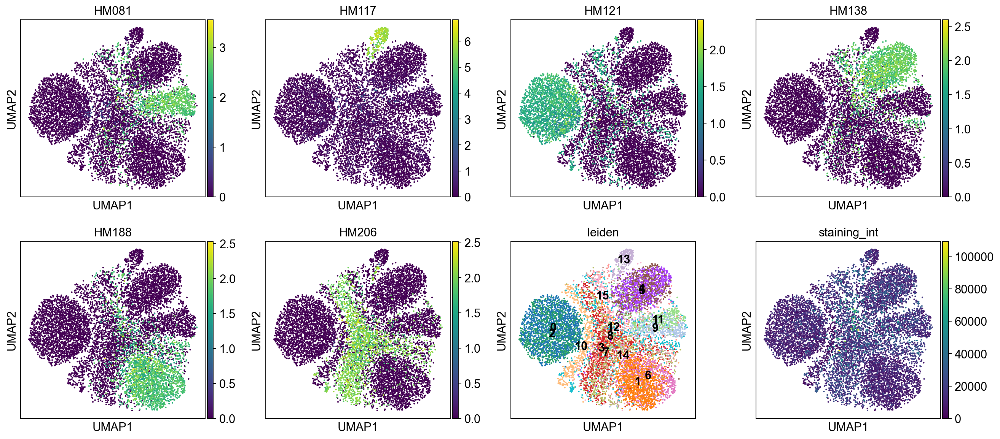

Sample 2


... storing 'feature_types' as categorical


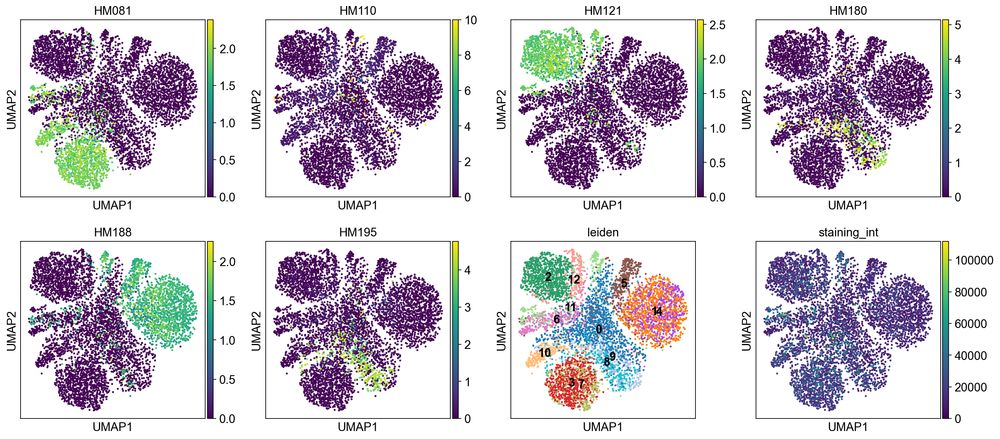

In [9]:
for i, adata_HTO in enumerate(adatas_HTO):
    print(names[i])
    sc.pl.umap(adata_HTO, color=keys[i].tolist()+['leiden','staining_int'], legend_loc='on data', vmin=0, ncols=4, save='_HTOs_'+names[i]+'.pdf')

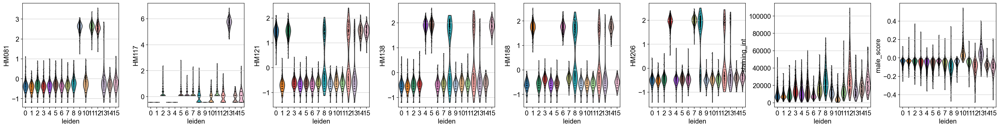

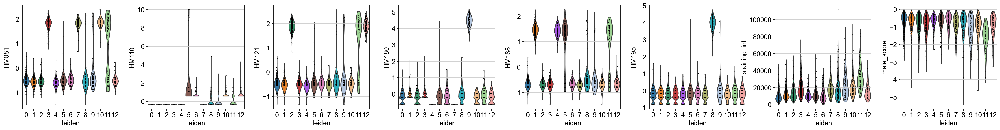

In [10]:
for i, adata_HTO in enumerate(adatas_HTO):
    sc.pl.violin(adata_HTO, keys=keys[i].tolist()+['staining_int','male_score'], groupby='leiden')

In [11]:
datas=[0]*2
datas[0]=pd.merge(adatas[0].obs, pd.DataFrame(adatas_HTO[0][:,adatas_HTO[0].var_names.isin(['HM081', 'HM117', 'HM121', 'HM138', 'HM188', 'HM206','HM110','HM180',
                                                   'HM195'])].X, columns=['HM081','HM117', 'HM121', 'HM138', 
                                                                                    'HM188', 'HM206'], index=adatas_HTO[0].obs_names), left_index=True, right_index=True)
datas[1]=pd.merge(adatas[1].obs, pd.DataFrame(adatas_HTO[1][:,adatas_HTO[1].var_names.isin(['HM081', 'HM117', 'HM121', 'HM138', 'HM188', 'HM206','HM110','HM180',
                                                   'HM195'])].X, columns=['HM081', 'HM110', 'HM121', 'HM180', 
                                                                                    'HM188', 'HM195'], index=adatas_HTO[1].obs_names), left_index=True, right_index=True)

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  del sys.path[0]
... storing 'cluster' as categorical
... storing 'status' as categorical
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  del sys.path[0]
... storing 'cluster' as categorical
... storing 'status' as categorical


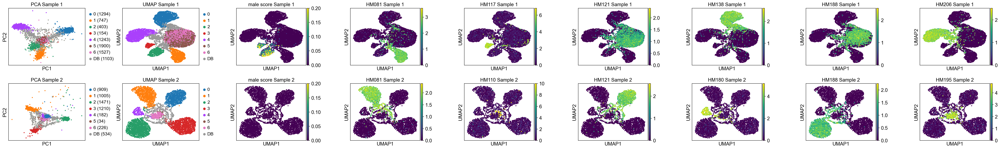

In [12]:
fig,ax=plt.subplots(ncols=9, nrows=2, figsize=(40,6))
fig.tight_layout(w_pad=5, h_pad=2)
n=[7,7]
soup_data=[0,0]
for i, path in enumerate(['./','./']):
    df=pd.read_csv(path+'souporcell_results_'+str(i+1)+'/clusters.tsv', sep='\t', index_col=0)
    df.loc[:,['cluster0','cluster1','cluster2','cluster3','cluster4'][:n[i]]].to_csv(path+'souporcell_results_'+str(i+1)+'/soupdata.csv')
    soup_data[i]=sc.read(path+'souporcell_results_'+str(i+1)+'/soupdata.csv')
    soup_data[i].X=soup_data[i].X*-1
    sc.pp.normalize_per_cell(soup_data[i], counts_per_cell_after=1e1)
    sc.pp.log1p(soup_data[i])
    soup_data[i].obs['cluster']=df.assignment.tolist()
    soup_data[i].obs['cluster'][soup_data[i].obs.cluster.str.contains('/')]='DB'
    soup_data[i].obs['status']=df.status.tolist()
    soup_data[i]=soup_data[i][soup_data[i].obs_names.isin(adatas[i].obs_names)]
    soup_data[i].obs=pd.merge(soup_data[i].obs, datas[i], left_index=True, right_index=True)
    soup_data[i].obs=pd.merge(soup_data[i].obs, adatas_HTO[i].obs['staining_int'], left_index=True, right_index=True)
    sc.tl.pca(soup_data[i], n_comps=2)
    sc.pp.neighbors(soup_data[i], n_neighbors=10)
    sc.tl.umap(soup_data[i], min_dist=1)
    sc.pl.pca(soup_data[i], color='cluster', ax=ax[i,0], legend_loc=None, show=False, title='PCA '+names[i], s=30)
    soup_data[i].uns['cluster_colors'][-1]='#999999'
    sc.pl.pca(soup_data[i], color='cluster', ax=ax[i,0], legend_loc='right margin', show=False, title='PCA '+names[i], s=30)
    L=ax[i,0].legend()
    for label in L.get_texts():
        label.set_text(label.get_text()+' ('+str(soup_data[i][soup_data[i].obs.cluster==label.get_text()].shape[0])+')')
    L.set_bbox_to_anchor((1, 1))
    L.get_frame().set_linewidth(0.0)
    sc.pl.umap(soup_data[i], color='cluster', ax=ax[i,1], legend_loc=None, show=False, title='UMAP '+names[i], s=30)
    soup_data[i].uns['cluster_colors'][-1]='#999999'
    sc.pl.umap(soup_data[i], color='cluster', ax=ax[i,1], show=False, title='UMAP '+names[i], s=30)
    sc.pl.umap(soup_data[i], color='male_score', ax=ax[i,2], show=False, title='male score '+names[i], s=30, vmin=0, vmax=0.2)
    for j, key in enumerate(keys[i].tolist()):
        sc.pl.umap(soup_data[i], color=key, ax=ax[i,(j+3)], show=False, title=key+' '+names[i], s=30, vmin=0)

fig.savefig('./figures/souporcell.pdf', bbox_inches='tight')

In [13]:
soup_names=soup_data[0][soup_data[0].obs.cluster=='6'].obs_names

In [14]:
HTO_names=adatas_HTO[0][adatas_HTO[0].obs.leiden.isin(['1','7'])].obs_names

In [15]:
unique, counts=np.unique(HTO_names.isin(soup_names), return_counts=True)
dict(zip(unique, counts))

{False: 519, True: 938}

## Preprocessing

In [16]:
adatas[0]=adatas[0][:,adatas[0].var.feature_types=='Gene Expression']
adatas[1]=adatas[1][:,adatas[1].var.feature_types=='Gene Expression']

Show those genes that yield the highest fraction of counts in each single cells, across all cells.

C:\ProgramData\Anaconda3\lib\site-packages\scanpy\preprocessing\_normalization.py:138: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)
C:\ProgramData\Anaconda3\lib\site-packages\scanpy\preprocessing\_normalization.py:138: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)


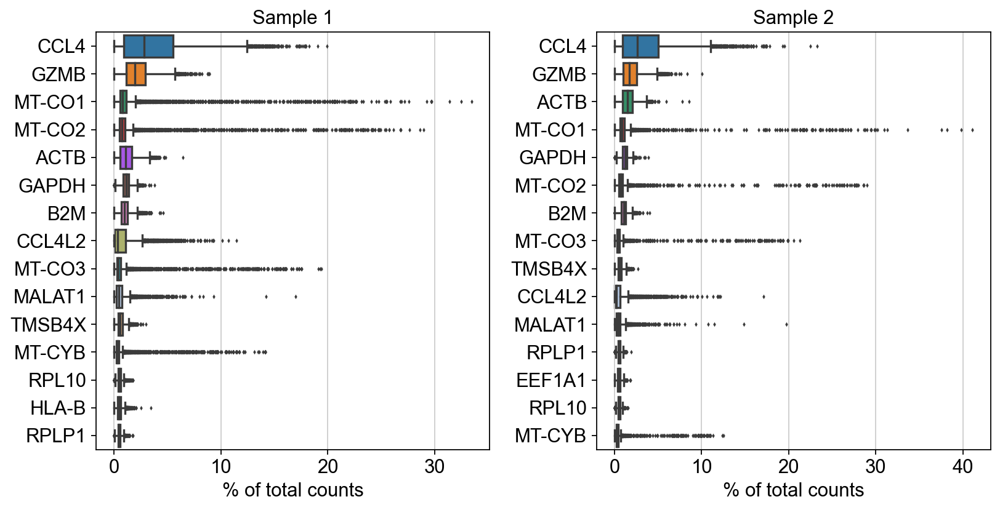

In [17]:
fig, ax = plt.subplots(ncols=len(adatas), figsize=(10,5))
fig.tight_layout(w_pad=3)
for i, adata in enumerate(adatas):
    sc.pl.highest_expr_genes(adata, n_top=15, ax=ax[i], show=False)
    ax[i].set_title(names[i])
fig.savefig('./figures/highest_expr_genes.pdf')

In the next step we will apply some bacic filters to these cells. Therefore we can control for the minimum number of genes per cell, to take this cell into account. A second filter will filter out genes, which are present in less than a certain number of cells.

In [18]:
for adata in adatas:
    sc.pp.filter_cells(adata, min_genes=200)
    sc.pp.filter_genes(adata, min_cells=3)

Note you can also use the function `pp.calculate_qc_metrics` to compute the fraction of mitochondrial genes and additional measures.

In [19]:
for adata in adatas:
    mito_genes = adata.var_names.str.startswith('MT-')
    adata.obs['percent_mito'] = np.sum(
    adata[:, mito_genes].X, axis=1).A1 / np.sum(adata.X, axis=1).A1
    adata.obs['n_counts'] = adata.X.sum(axis=1).A1

In [20]:
for adata in adatas:
    ribo_genes = ((adata.var_names.str.startswith("RPL")) | (adata.var_names.str.startswith("RPS"))| (adata.var_names.str.startswith("MPL")))
    adata.obs['percent_ribo'] = np.sum(
    adata[:, ribo_genes].X, axis=1) / np.sum(adata.X, axis=1)
    adata.var['ribo'] = ribo_genes

In [21]:
activation_genes=pd.read_csv("./analysis_info/activation_genes.txt", sep='\t')

In [22]:
activation_gene_list=[x.upper() for x in activation_genes.iloc[:,0].unique().tolist()]
activation_gene_list=activation_gene_list+['CCL4','CCL5','KLRG1','GZMB','GZMK','GZMA','GZMH','XCL1','XCL2','CD82','CD74','PRF1','CD27']+adata.var_names[adata.var_names.str.contains('HLA-D')].tolist()

In [23]:
activation_gene_list_small=['GZMA','GZMB','IFNG','IL2RA','CD27','XCL1','PRF1','CCL4']

In [24]:
for adata in adatas:
    sc.tl.score_genes(adata, activation_gene_list, score_name='activation_score')
    sc.tl.score_genes(adata, activation_gene_list_small, score_name='activation_score_mod')

A violin plot of the computed quality measures.

... storing 'feature_types' as categorical


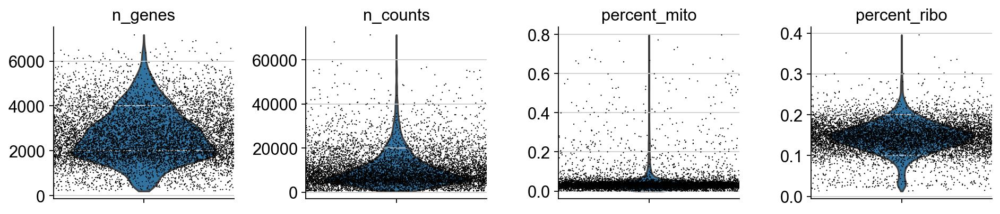

... storing 'feature_types' as categorical


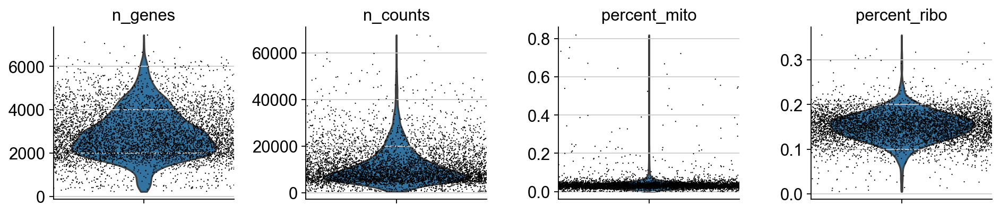

In [25]:
for adata in adatas:
    sc.pl.violin(adata, ['n_genes', 'n_counts', 'percent_mito', 'percent_ribo'],
             jitter=0.5, multi_panel=True)

Remove cells that have too many mitochondrial genes expressed or too many total counts. First, plot the counts versus the percentage of mitochondrial genes and versus the number of genes to define a threshold for later filtering.

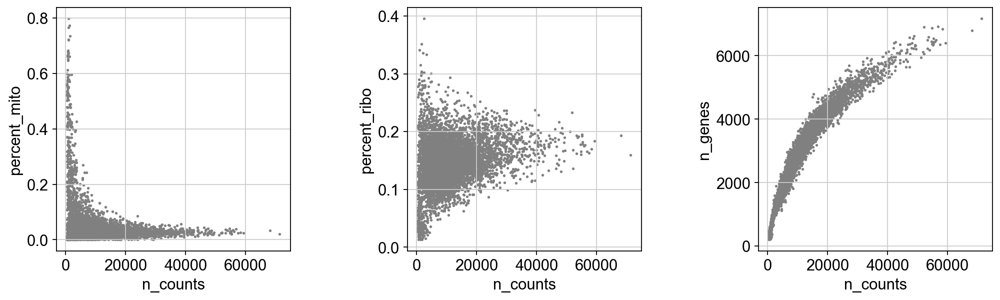

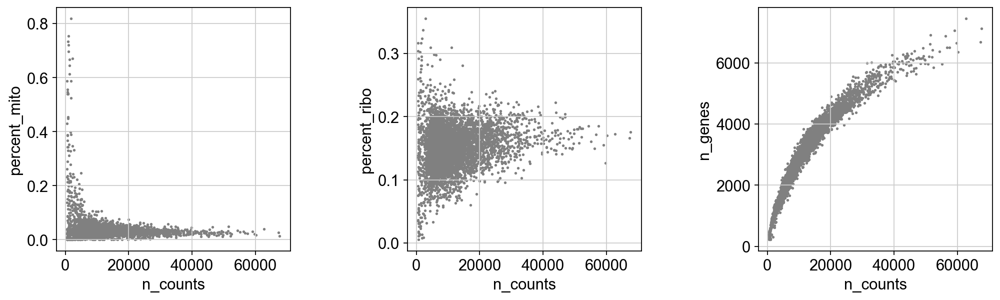

In [26]:
for adata in adatas:
    counts = adata.obs['n_counts']
    mito = adata.obs['percent_mito']
    genes = adata.obs['n_genes']
    ribo = adata.obs['percent_ribo']
    fig = plt.figure(figsize=(15, 4))
    grid = plt.GridSpec(1, 3, hspace=0, wspace=0.5)
    percent_mito = fig.add_subplot(grid[0, 0], xlabel='n_counts', ylabel='percent_mito')
    percent_ribo = fig.add_subplot(grid[0, 1], xlabel='n_counts', ylabel='percent_ribo')
    n_genes = fig.add_subplot(grid[0, 2], xlabel='n_counts', ylabel='n_genes')
    percent_mito.scatter(counts, mito, s=2, c='gray')
    percent_ribo.scatter(counts, ribo, s=2, c='gray')
    n_genes.scatter(counts, genes, s=2, c='gray')

Actually do the filtering from the cut-off defined above.

In [27]:
counts_before=[adatas[0].n_obs, adatas[1].n_obs]
adatas[0] = adatas[0][adatas[0].obs['n_genes'] < 6000, :]
adatas[0] = adatas[0][adatas[0].obs['n_counts'] < 40000, :]
adatas[0] = adatas[0][adatas[0].obs['percent_mito'] < 0.2, :]

adatas[1] = adatas[1][adatas[1].obs['n_genes'] < 6000, :]
adatas[1] = adatas[1][adatas[1].obs['n_counts'] < 40000, :]
adatas[1] = adatas[1][adatas[1].obs['percent_mito'] < 0.2, :]

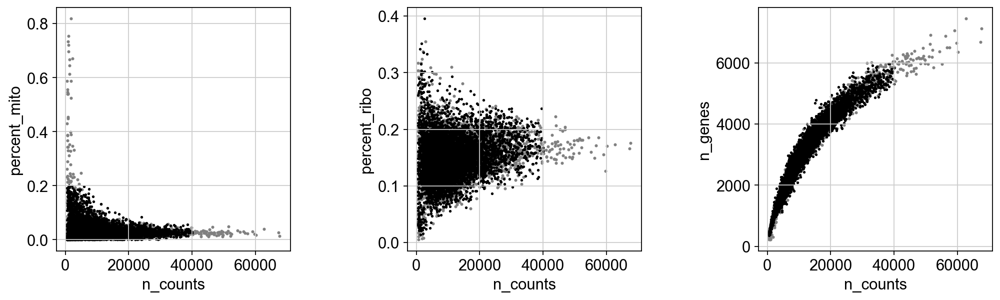

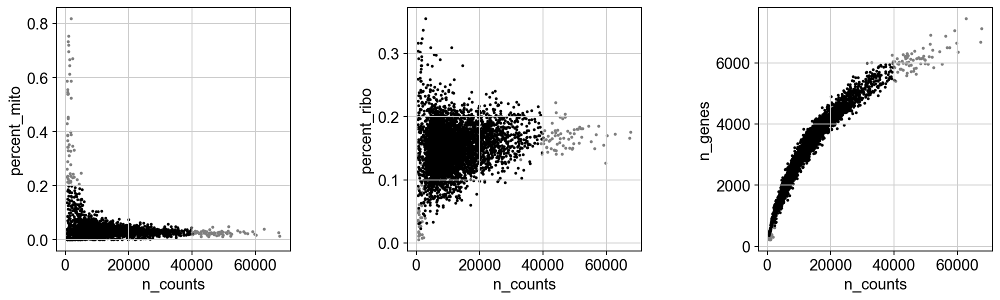

In [28]:
for adata in adatas:
    counts2 = adata.obs['n_counts']
    mito2 = adata.obs['percent_mito']
    genes2 = adata.obs['n_genes']
    ribo2 = adata.obs['percent_ribo']

    fig = plt.figure(figsize=(15, 4))
    grid = plt.GridSpec(1, 3, hspace=0, wspace=0.5)
    percent_mito = fig.add_subplot(grid[0, 0], xlabel='n_counts', ylabel='percent_mito')
    percent_ribo = fig.add_subplot(grid[0, 1], xlabel='n_counts', ylabel='percent_ribo')
    n_genes = fig.add_subplot(grid[0, 2], xlabel='n_counts', ylabel='n_genes')

    percent_mito.scatter(counts, mito, s=3, c='gray')
    percent_ribo.scatter(counts, ribo, s=3, c='gray')
    n_genes.scatter(counts, genes, s=3, c='gray')
    percent_mito.scatter(counts2, mito2, s=2, c='black')
    percent_ribo.scatter(counts2, ribo2, s=2, c='black')
    n_genes.scatter(counts2, genes2, s=2, c='black')

fig.savefig('./figures/filtering.pdf', dpi=2000)

In [29]:
for i, adata in enumerate(adatas):
    print(names[i]+': '+str(counts_before[i])+' --> '+str(adata.n_obs))

Sample 1: 8278 --> 7962
Sample 2: 5506 --> 5386


Total-count normalize (library-size correct) the data matrix to 10,000 reads per cell, so that counts become comparable among cells.

In [30]:
for adata in adatas:
    sc.pp.normalize_per_cell(adata, counts_per_cell_after=1e4)
    sc.pp.log1p(adata)

Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.


Logarithmize the data.

## Cell cycle scoring

In [31]:
cc_genes=pd.read_csv("./analysis_info/regev_lab_cell_cycle_genes.txt")
s_genes=cc_genes[:46]
g2m_genes=cc_genes[47:]
s_genes.columns=['genes']
g2m_genes.columns=['genes']
for adata in adatas:
    sc.tl.score_genes_cell_cycle(adata, s_genes.genes, g2m_genes.genes)

... storing 'phase' as categorical
... storing 'phase' as categorical


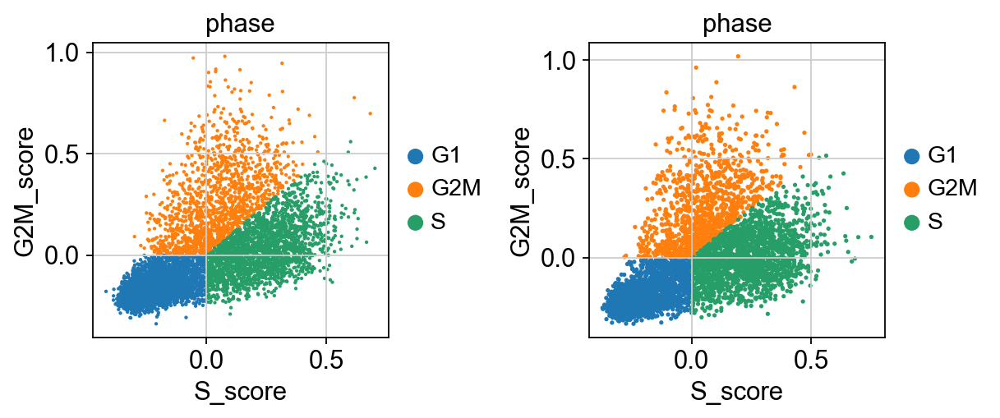

In [32]:
fig, ax = plt.subplots(ncols=len(adatas), figsize=(7,3))
fig.tight_layout(w_pad=5)
for i, adata in enumerate(adatas):
    sc.pl.scatter(adata, x='S_score', y='G2M_score', color='phase', ax=ax[i], show=False)

Set the `.raw` attribute of AnnData object to the logarithmized raw gene expression for later use in differential testing and visualizations of gene expression. This simply freezes the state of the AnnData object. While many people consider the normalized data matrix as the "relevant data" for visualization and differential testing, some would prefer to store the unnormalized data.

In [33]:
for adata in adatas:
    adata.raw = adata

In [34]:
adata=adatas[0].concatenate(adatas[1])

## Demultiplexing

In [35]:
pd.set_option('mode.chained_assignment', None)
adata.obs['samplename']='None'
adata.obs.samplename[np.logical_and(adata.obs_names.isin(soup_data[0][soup_data[0].obs.cluster=='0'].obs_names.values+'-0'),adata.obs.batch=='0')]='HM138_01'
adata.obs.samplename[np.logical_and(adata.obs_names.isin(soup_data[0][soup_data[0].obs.cluster=='1'].obs_names.values+'-0'),adata.obs.batch=='0')]='HM081_42'
adata.obs.samplename[np.logical_and(adata.obs_names.isin(soup_data[0][soup_data[0].obs.cluster=='2'].obs_names.values+'-0'),adata.obs.batch=='0')]='HM103_01'
adata.obs.samplename[np.logical_and(adata.obs_names.isin(soup_data[0][soup_data[0].obs.cluster=='3'].obs_names.values+'-0'),adata.obs.batch=='0')]='HM117_20'
adata.obs.samplename[np.logical_and(adata.obs_names.isin(soup_data[0][soup_data[0].obs.cluster=='4'].obs_names.values+'-0'),adata.obs.batch=='0')]='HM206_16'
adata.obs.samplename[np.logical_and(adata.obs_names.isin(soup_data[0][soup_data[0].obs.cluster=='5'].obs_names.values+'-0'),adata.obs.batch=='0')]='HM121_13'
adata.obs.samplename[np.logical_and(adata.obs_names.isin(soup_data[0][soup_data[0].obs.cluster=='6'].obs_names.values+'-0'),adata.obs.batch=='0')]='HM188_13'

adata.obs.samplename[np.logical_and(adata.obs_names.isin(soup_data[1][soup_data[1].obs.cluster=='0'].obs_names.values+'-1'),adata.obs.batch=='1')]='HM121_14'
adata.obs.samplename[np.logical_and(adata.obs_names.isin(soup_data[1][soup_data[1].obs.cluster=='1'].obs_names.values+'-1'),adata.obs.batch=='1')]='HM081_23'
adata.obs.samplename[np.logical_and(adata.obs_names.isin(soup_data[1][soup_data[1].obs.cluster=='2'].obs_names.values+'-1'),adata.obs.batch=='1')]='HM188_14'
adata.obs.samplename[np.logical_and(adata.obs_names.isin(soup_data[1][soup_data[1].obs.cluster=='3'].obs_names.values+'-1'),adata.obs.batch=='1')]='HM117_22'
adata.obs.samplename[np.logical_and(adata.obs_names.isin(soup_data[1][soup_data[1].obs.cluster=='4'].obs_names.values+'-1'),adata.obs.batch=='1')]='HM180_38'
adata.obs.samplename[np.logical_and(adata.obs_names.isin(soup_data[1][soup_data[1].obs.cluster=='5'].obs_names.values+'-1'),adata.obs.batch=='1')]='HM110_01'
adata.obs.samplename[np.logical_and(adata.obs_names.isin(soup_data[1][soup_data[1].obs.cluster=='6'].obs_names.values+'-1'),adata.obs.batch=='1')]='HM195_35'

adata=adata[adata.obs.samplename!='None']

Identify highly-variable genes.

In [36]:
sc.pp.highly_variable_genes(adata, min_mean=0.0125, max_mean=3, min_disp=0.5)

Trying to set attribute `.uns` of view, copying.


In [37]:
adata = adata[:, adata.var['highly_variable']]
sc.pp.regress_out(adata, ['n_counts', 'percent_mito', 'S_score', 'G2M_score'])
sc.pp.scale(adata, max_value=10)

C:\Users\Administrator\AppData\Roaming\Python\Python36\site-packages\anndata\_core\anndata.py:1208: ImplicitModificationWarning: Initializing view as actual.
  "Initializing view as actual.", ImplicitModificationWarning
Trying to set attribute `.obs` of view, copying.
... storing 'samplename' as categorical


## Principal component analysis

In [38]:
sc.tl.pca(adata, svd_solver='arpack')

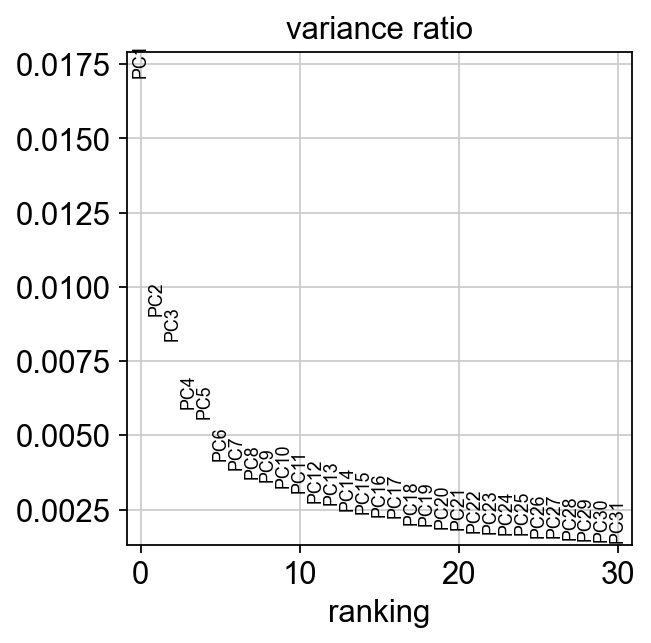

In [39]:
sc.pl.pca_variance_ratio(adata)

## Computing the neighborhood graph

Let us compute the neighborhood graph of cells using the PCA representation of the data matrix. You might simply use default values here. For the sake of reproducing Seurat's results, let's take the following values.

In [40]:
sc.pp.neighbors(adata, n_neighbors=10, n_pcs=7)

## Embedding the neighborhood graph

In [41]:
sc.tl.umap(adata)

## Batch effect correction

In [42]:
sc.external.pp.bbknn(adata, batch_key='samplename')
sc.tl.umap(adata, min_dist=0.75)

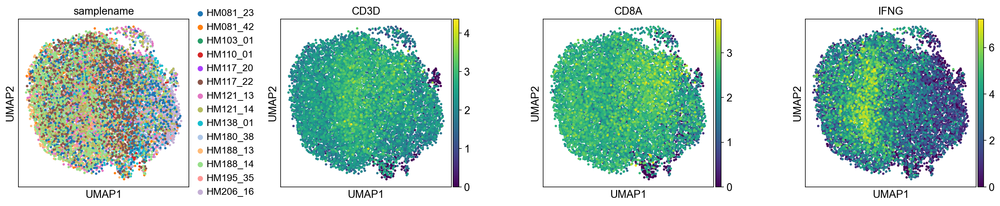

In [43]:
sc.pl.umap(adata, color=['samplename', 'CD3D', 'CD8A', 'IFNG'], wspace=0.4, s=40)

## Clustering the neighborhood graph

In [44]:
from sklearn.metrics import silhouette_score
def titrate_leiden_resolution(adata):
    res_array=list(np.round(np.linspace(.1, 2, 20),1))
    silhoutte_list=list()
    sc.settings.verbosity = 1
    for i,res in enumerate(res_array):
        sc.tl.leiden(adata, resolution=res)
        if adata.obs.leiden.unique().shape[0]>2:
            silhoutte_list.append(silhouette_score(adata.obsm['X_umap'],
                    adata.obs[f'leiden'],
                    metric='euclidean'))
        else:
            silhoutte_list.append(np.nan)
        print(str(np.round(((i+1)/len(res_array))*100,1))+"%", end="\r", flush=True)
    sns.lineplot(res_array, silhoutte_list)
    print(silhoutte_list)

[nan, nan, nan, 0.29197136, 0.10047347, 0.14185834, 0.18029349, 0.1727933, 0.1827184, 0.16540076, 0.051881794, 0.0677991, 0.03718613, 0.0494228, 0.07332675, 0.03882517, 0.02741924, 0.02018385, 0.021999171, 0.0025683122]


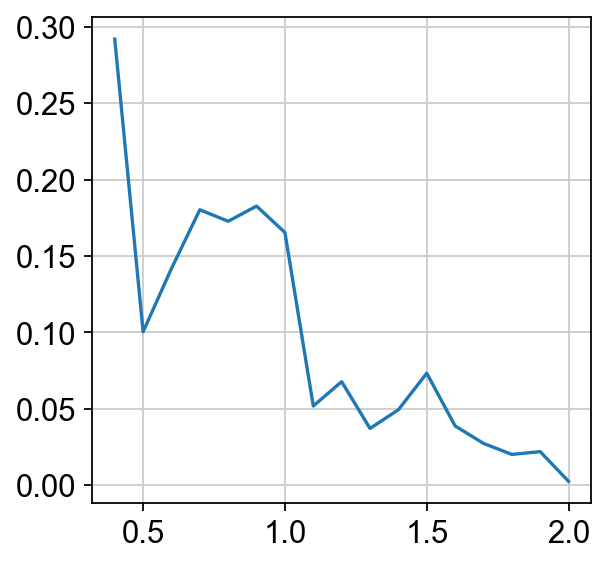

In [45]:
titrate_leiden_resolution(adata)

In [46]:
sc.tl.leiden(adata, resolution=0.9)
print(silhouette_score(adata.obsm['X_umap'],adata.obs[f'leiden'],metric='euclidean'))

0.1827184


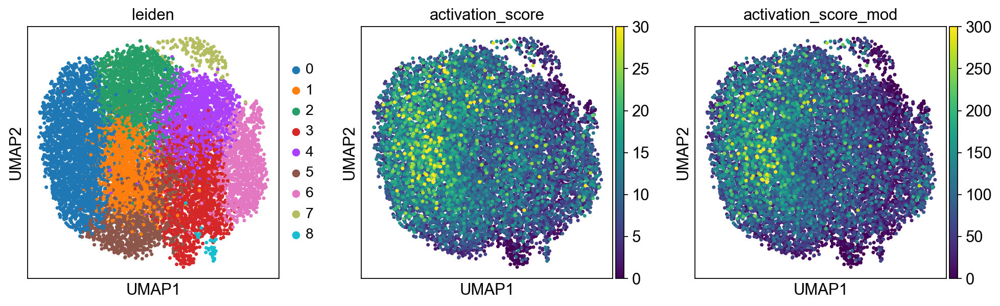

In [47]:
sc.pl.umap(adata, color=['leiden', 'activation_score','activation_score_mod'], vmin=0, vmax=[0,30,300], save='_leiden.pdf', s=40)

In [48]:
single_donor_adatas=[0]*len(adata.obs.samplename.unique())
single_donor_adatas_names=[0]*len(adata.obs.samplename.unique())

In [49]:
for i in range(len(adata.obs.samplename.unique())):
    single_donor_adatas[i]=adata[adata.obs['samplename']==adata.obs.samplename.unique()[i],:]
    single_donor_adatas_names[i]=adata.obs.samplename.unique()[i]

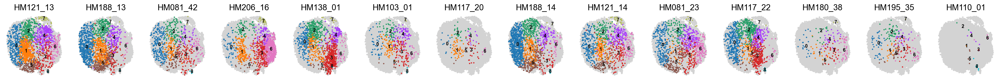

In [50]:
fig, ax = plt.subplots(ncols=14, figsize=(30, 2))
for i, adata_single in enumerate(single_donor_adatas):
    sc.pl.umap(adata, color=None, legend_loc='on data', legend_fontsize=8, frameon=False, ax=ax[i], show=False, s=30)
    sc.pl.umap(adata_single, color='leiden', legend_loc='on data', title=single_donor_adatas_names[i], legend_fontsize=8, frameon=False, ax=ax[i], show=False,s=20)
fig.savefig('./figures/umaps_donors.pdf')

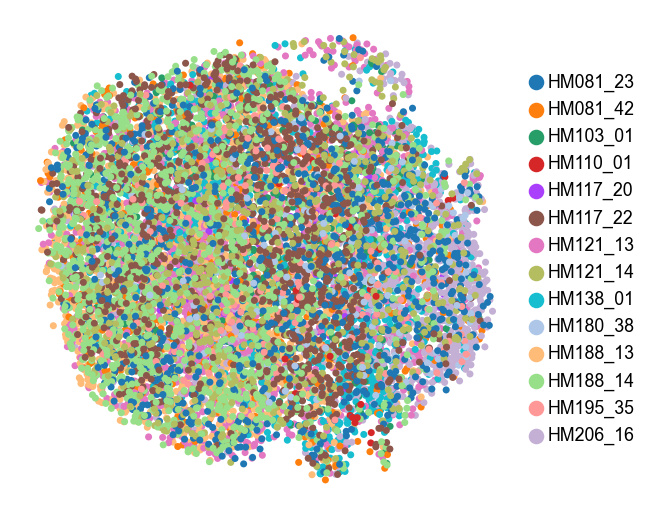

In [51]:
sc.pl.umap(adata, color='samplename', legend_loc='right margin', title='', legend_fontsize=8, frameon=False, save='_donors.pdf', s=40)

## Finding marker genes

Let us compute a ranking for the highly differential genes in each cluster. For this, by default, the `.raw` attribute of AnnData is used in case it has been initialized before. The simplest and fastest method to do so is the t-test.

In [52]:
sc.settings.verbosity = 2  # reduce the verbosity

    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns["dendrogram_['leiden']"]`
ranking genes
    finished (0:00:03)


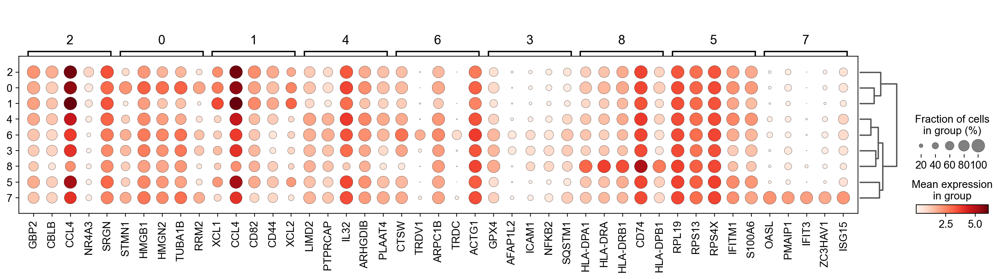

In [53]:
sc.tl.dendrogram(adata, groupby='leiden')
sc.tl.rank_genes_groups(adata, 'leiden', use_raw='true', method='t-test')
sc.pl.rank_genes_groups_dotplot(adata, n_genes=5)

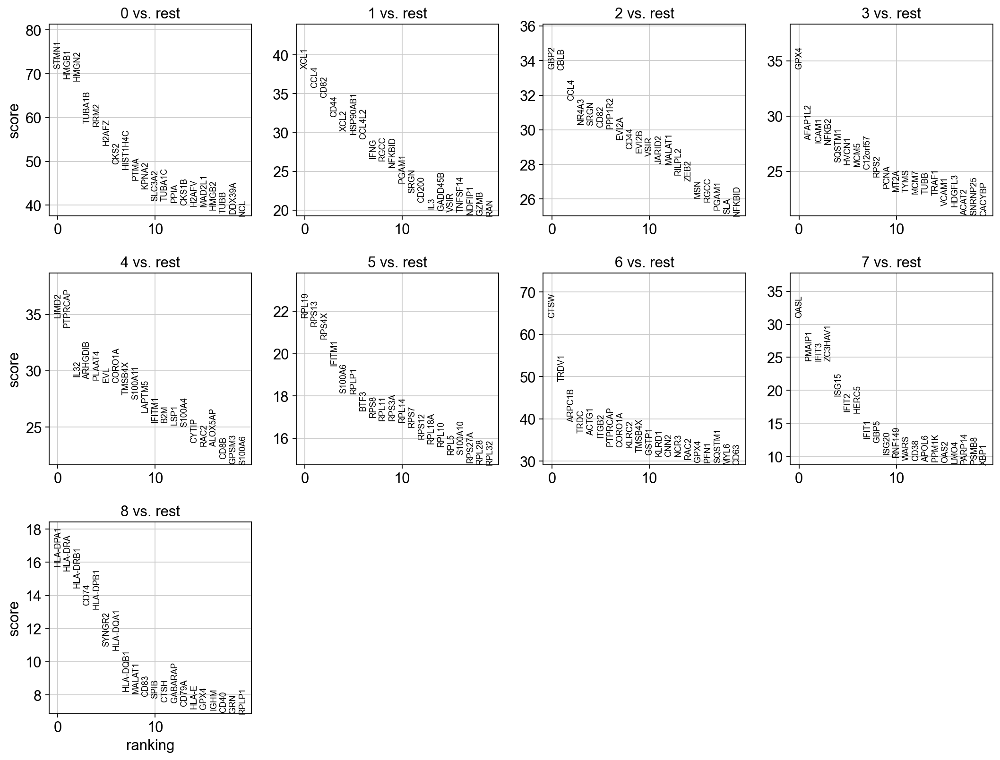

In [54]:
sc.pl.rank_genes_groups(adata, n_genes=20, sharey=False)

In [55]:
result = adata.uns['rank_genes_groups']
groups = result['names'].dtype.names
pd.DataFrame(
    {group + '_' + key: result[key][group]
    for group in groups for key in ['names', 'pvals']}).to_csv('marker_genes.csv')

In [56]:
marker_genes=['CD3D', 'CD3E', 'CD3G', 'CD2', 'CD8A', 'CD8B', 'CD4', 'IL7R', 'XCL1', 'CCR7', 'CCL4', 
              'CCR5','CXCR3', 'GZMB', 'PRF1', 'IL2RA', 'SELL', 'CD27', 'CD69', 'FAS','PDCD1', 'TCF7', 'HAVCR2','LAG3',
              'IFNG', 'IL2', 'IL10', 'TBX21', 'GATA3', 'RORC']

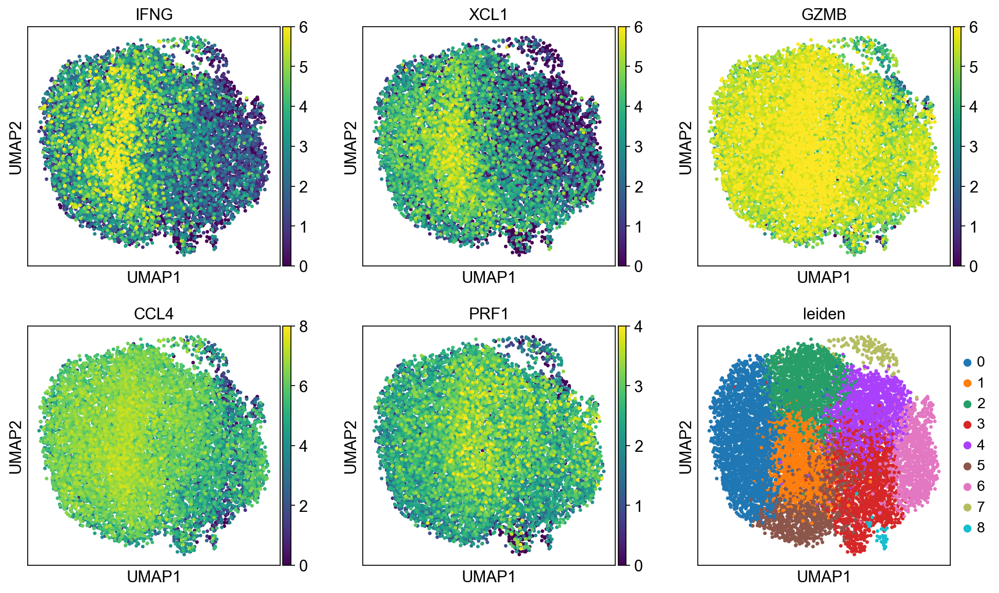

In [57]:
sc.pl.umap(adata, color=['IFNG','XCL1', 'GZMB', 'CCL4', 'PRF1', 'leiden'], ncols=3, vmax=[6,6,6,8,4], save='_activation_marker_genes.pdf', s=40)

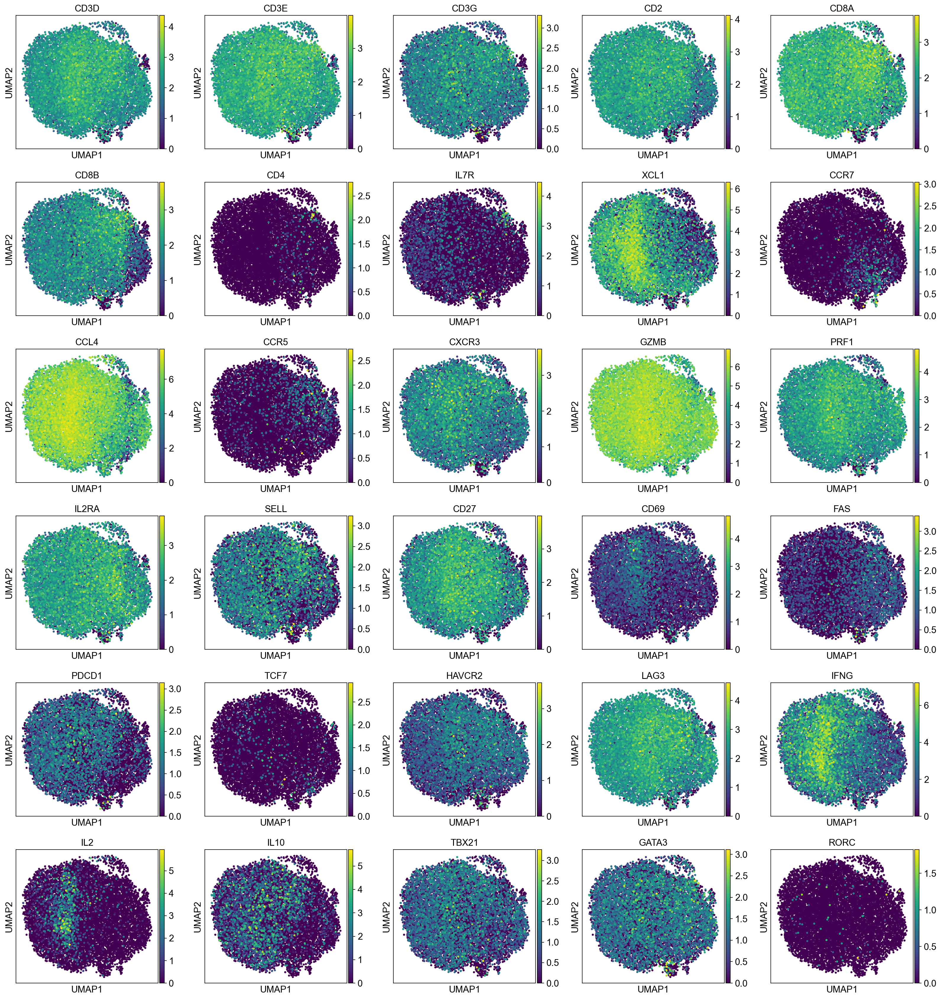

In [58]:
sc.pl.umap(adata, color=marker_genes, ncols=5, save='_marker_genes.pdf', s=40)

# TCR analysis scirpy

In [59]:
adata_TCR_1=ir.io.read_10x_vdj('./VDJ_1/outs/all_contig_annotations.csv')
adata_TCR_2=ir.io.read_10x_vdj('./VDJ_2/outs/all_contig_annotations.csv')

... storing 'TRA_1_cdr3' as categorical
... storing 'TRA_2_cdr3' as categorical
... storing 'TRB_1_cdr3' as categorical
... storing 'TRB_2_cdr3' as categorical
... storing 'TRA_1_junction_ins' as categorical
... storing 'TRA_2_junction_ins' as categorical
... storing 'TRB_1_junction_ins' as categorical
... storing 'TRB_2_junction_ins' as categorical
... storing 'TRA_1_v_gene' as categorical
... storing 'TRA_2_v_gene' as categorical
... storing 'TRB_1_v_gene' as categorical
... storing 'TRB_2_v_gene' as categorical
... storing 'TRB_1_d_gene' as categorical
... storing 'TRB_2_d_gene' as categorical
... storing 'TRA_1_j_gene' as categorical
... storing 'TRA_2_j_gene' as categorical
... storing 'TRB_1_j_gene' as categorical
... storing 'TRB_2_j_gene' as categorical
... storing 'TRA_1_c_gene' as categorical
... storing 'TRA_2_c_gene' as categorical
... storing 'TRB_1_c_gene' as categorical
... storing 'TRB_2_c_gene' as categorical
... storing 'TRA_1_cdr3_nt' as categorical
... storing 'TRA_

In [60]:
adata_TCR_1.obs_names = adata_TCR_1.obs_names+'-0'
adata_TCR_2.obs_names = adata_TCR_2.obs_names+'-1'

In [61]:
concat_obs_data=pd.concat([adata_TCR_1.obs,adata_TCR_2.obs])

In [62]:
import anndata
adata_TCR = anndata.AnnData(obs=concat_obs_data)

In [63]:
ir.pp.merge_with_tcr(adata, adata_TCR)

... storing 'multi_chain' as categorical
... storing 'TRA_1_cdr3' as categorical
... storing 'TRA_2_cdr3' as categorical
... storing 'TRB_1_cdr3' as categorical
... storing 'TRB_2_cdr3' as categorical
... storing 'TRA_1_v_gene' as categorical
... storing 'TRA_2_v_gene' as categorical
... storing 'TRB_1_v_gene' as categorical
... storing 'TRB_2_v_gene' as categorical
... storing 'TRB_2_d_gene' as categorical
... storing 'TRA_1_j_gene' as categorical
... storing 'TRA_2_j_gene' as categorical
... storing 'TRB_2_j_gene' as categorical
... storing 'TRA_2_c_gene' as categorical
... storing 'TRA_1_cdr3_nt' as categorical
... storing 'TRA_2_cdr3_nt' as categorical
... storing 'TRB_1_cdr3_nt' as categorical
... storing 'TRB_2_cdr3_nt' as categorical
... storing 'has_tcr' as categorical


In [64]:
ir.tl.chain_pairing(adata)

... storing 'chain_pairing' as categorical


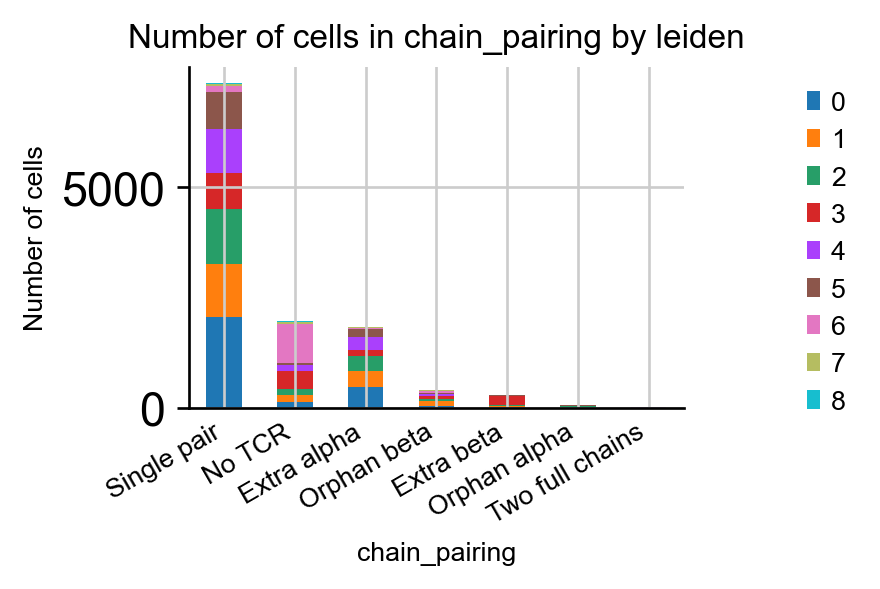

In [65]:
ir.pl.group_abundance(adata, groupby="chain_pairing", target_col="leiden")

In [66]:
adata_small=sc.pp.subsample(adata, n_obs=500, copy=True)

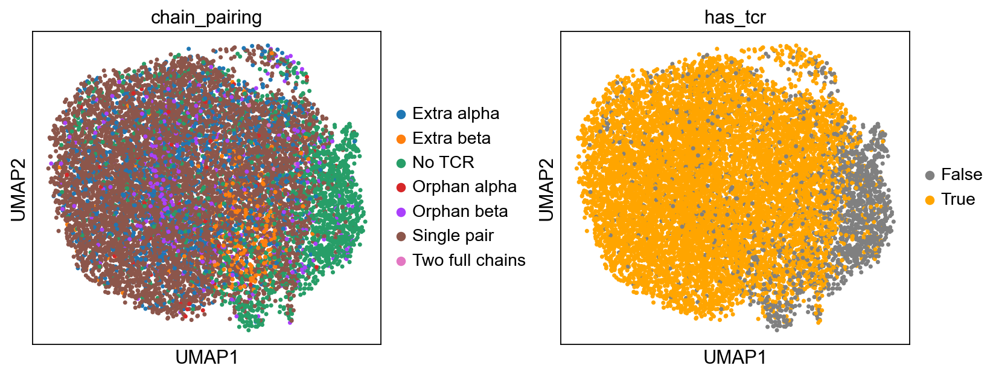

In [67]:
fig, ax = plt.subplots(ncols=2, figsize=(10,4))
fig.tight_layout(w_pad=7)
sc.pl.umap(adata, color="chain_pairing", ax=ax[0], show=False, s=40)
sc.pl.umap(adata, color="has_tcr", palette=['gray','orange'], ax=ax[1], show=False, s=40)

In [68]:
print('TCR sequencing efficiency: '+str(np.round(adata.obs.has_tcr.value_counts(normalize=True)[0]*100,1))+'%')
print('Unique CDR3 alpha: '+str(adata.obs.TRA_1_cdr3.append(adata.obs.TRA_2_cdr3).nunique()))
print('Unique CDR3 beta: '+str(adata.obs.TRB_1_cdr3.append(adata.obs.TRB_2_cdr3).nunique()))

TCR sequencing efficiency: 83.5%
Unique CDR3 alpha: 598
Unique CDR3 beta: 573


In [69]:
print(
    "Fraction of cells with more than one pair of TCRs: {:.2f}".format(
        np.sum(
            adata.obs["chain_pairing"].isin(
                ["Extra beta", "Extra alpha", "Two full chains"]
            )
        )
        / adata.n_obs
    )
)

Fraction of cells with more than one pair of TCRs: 0.18


In [70]:
adata = adata[adata.obs["multi_chain"] != "True", :].copy()

In [71]:
adata_small=sc.pp.subsample(adata, n_obs=5000, copy=True)

In [72]:
ir.pp.tcr_neighbors(adata, receptor_arms="all", dual_tcr="all")
ir.tl.define_clonotypes(adata)

Initializing TcrNeighbors object...
Finished initalizing TcrNeighbors object.  (0:00:02)
Computing TRA pairwise distances...
Finished computing TRA pairwise distances. (0:00:00)
Computing TRB pairwise distances...
Finished computing TRB pairwise distances. (0:00:00)
Started comstructing TRA coord-dictionary...


100%|████████████████████████████████████████████████████████████████████████████████| 618/618 [00:12<00:00, 25.32it/s]


Finished constructing TRA coord-dictionary (0:00:12)
Started comstructing TRB coord-dictionary...


100%|████████████████████████████████████████████████████████████████████████████████| 606/606 [00:06<00:00, 94.17it/s]


Finished constructing TRB coord-dictionary (0:00:06)
Constructing cell x cell distance matrix...


100%|█████████████████████████████████████████████████████████████████████| 2770198/2770198 [00:33<00:00, 83839.93it/s]


Finished constructing cell x cell distance matrix.  (0:00:33)


... storing 'clonotype' as categorical


array([<matplotlib.axes._subplots.AxesSubplot object at 0x00000226D5F14198>,
      dtype=object)

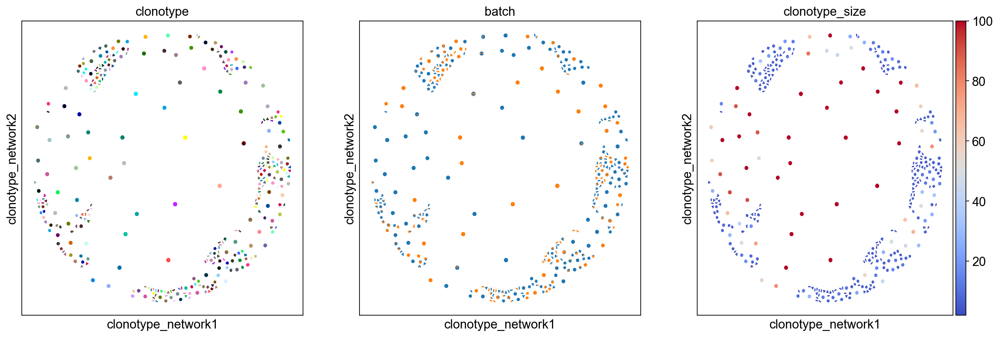

In [73]:
ir.tl.clonotype_network(adata, layout='fr', min_size=2)
ir.pl.clonotype_network(adata, color=["clonotype","batch","clonotype_size"], legend_loc="none", color_map="coolwarm",vmax=100, panel_size=(6, 6), size=10)

In [74]:
for i in range(len(adata.obs.samplename.unique())):
    single_donor_adatas[i]=adata[adata.obs['samplename']==adata.obs.samplename.unique()[i],:]
    single_donor_adatas_names[i]=adata.obs.samplename.unique()[i]

C:\Users\Administrator\AppData\Roaming\Python\Python36\site-packages\anndata\compat\__init__.py:215: FutureWarning: During AnnData slicing, found matrix at .uns['tcr_neighbors_nt_identity']['connectivities'] that happens to be dimensioned at n_obs×n_obs (11914×11914).

These matrices should now be stored in the .obsp attribute.
This slicing behavior will be removed in anndata 0.8.
  FutureWarning,
C:\Users\Administrator\AppData\Roaming\Python\Python36\site-packages\anndata\compat\__init__.py:215: FutureWarning: During AnnData slicing, found matrix at .uns['tcr_neighbors_nt_identity']['distances'] that happens to be dimensioned at n_obs×n_obs (11914×11914).

These matrices should now be stored in the .obsp attribute.
This slicing behavior will be removed in anndata 0.8.
  FutureWarning,


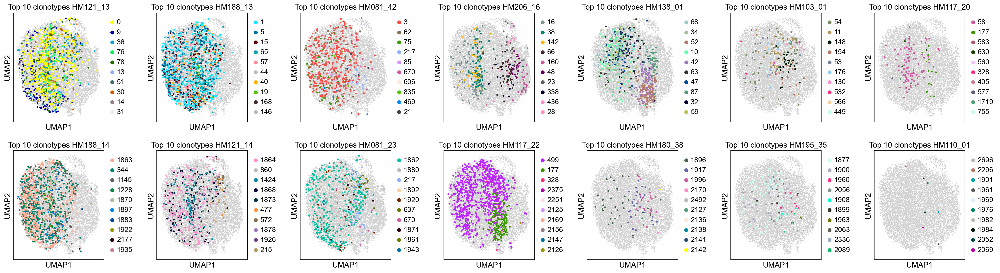

In [75]:
fig, ax =plt.subplots(ncols=7, nrows=2, figsize=(25,7))
fig.tight_layout(w_pad=4, h_pad=2)
for i, adata_s in enumerate (single_donor_adatas):
    sc.pl.umap(adata, ax=ax.reshape(-1)[i], show=False)
    sc.pl.umap(adata_s, color='clonotype', 
               groups=adata_s.obs.clonotype.value_counts().index[:10].astype(str).tolist(), 
               ax=ax.reshape(-1)[i], show=False, title='Top 10 clonotypes '+single_donor_adatas_names[i], s=40)
#sc.pl.umap(adata, color='clonotype', 
#           groups=adata.obs.clonotype.value_counts().index[:10].astype(str).tolist(), 
#           ax=ax.reshape(-1)[11], show=False, title='Top 10 clonotypes combined')
fig.savefig('./figures/clonotypes_clusters_donors.pdf', bbox_inches='tight')

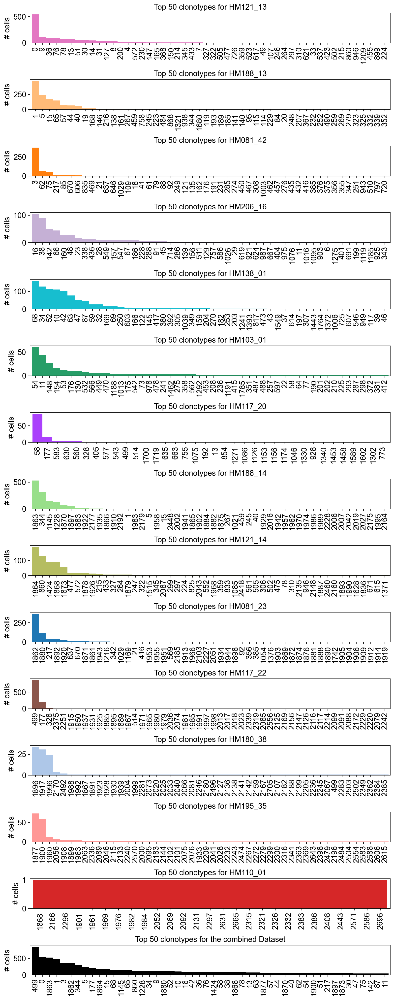

In [76]:
fig, ax=plt.subplots(nrows=15, figsize=(10,25))
fig.tight_layout(h_pad=3)
for i, adata_s in enumerate(single_donor_adatas):
    adata_s.obs.clonotype.value_counts().sort_values(ascending=False)[:50].plot(kind='bar', ax=ax[i], width=1, color=adata_s.uns['samplename_colors'][0])
    ax[i].grid(False)
    ax[i].set_title('Top 50 clonotypes for '+single_donor_adatas_names[i])
    ax[i].set_ylabel('# cells')
    #ax[i].set_ylim(0,900)
adata.obs.clonotype.value_counts().sort_values(ascending=False)[:50].plot(kind='bar', ax=ax[14], width=1, color = 'black')
ax[14].grid(False)
ax[14].set_title('Top 50 clonotypes for the combined Dataset')
ax[14].set_ylabel('# cells')
fig.savefig('./figures/clonotypes_sizes_donors.pdf', bbox_inches='tight')

In [77]:
adata.write('COVID_II.h5ad')